# Исследование объявлений о продаже квартир

В вашем распоряжении данные сервиса Яндекс.Недвижимость — архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктов за несколько лет. Нужно научиться определять рыночную стоимость объектов недвижимости. Ваша задача — установить параметры. Это позволит построить автоматизированную систему: она отследит аномалии и мошенническую деятельность. 

По каждой квартире на продажу доступны два вида данных. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта, ближайшего парка и водоёма. 

### Откройте файл с данными и изучите общую информацию. 

Импортируем библиотеку pandas.  
Для построения графиков импортируем plotly.express.  
Считаем данные из csv-файла в датафрейм и сохраним в переменную df.  
Путь к файлу: /datasets/real_estate_data.csv

In [1]:
import pandas as pd
import plotly.express as px

In [2]:
# для того чтобы при выводе были видны сразу все колонки зададим свойство display.max_columns
pd.set_option('display.max_columns', 100)

In [3]:
try:
    df = pd.read_csv('C:/projects/python_proj/ds_practicum/datasets/real_estate_data.csv', sep='\t')
except:
    df = pd.read_csv('/datasets/real_estate_data.csv', sep='\t')

Выведем первые 10 строк датафрейма на экран

In [4]:
df.head(10)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.00,2019-03-07T00:00:00,3,2.70,16.0,51.00,8,NaN,False,False,25.00,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.40,2018-12-04T00:00:00,1,NaN,11.0,18.60,1,NaN,False,False,11.00,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.00,2015-08-20T00:00:00,2,NaN,5.0,34.30,4,NaN,False,False,8.30,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.00,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,False,False,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.00,2018-06-19T00:00:00,2,3.03,14.0,32.00,13,NaN,False,False,41.00,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0
5,10,2890000.0,30.40,2018-09-10T00:00:00,1,NaN,12.0,14.40,5,NaN,False,False,9.10,NaN,городской посёлок Янино-1,NaN,NaN,NaN,NaN,NaN,NaN,55.0
6,6,3700000.0,37.30,2017-11-02T00:00:00,1,NaN,26.0,10.60,6,NaN,False,False,14.40,1.0,посёлок Парголово,52996.0,19143.0,0.0,NaN,0.0,NaN,155.0
7,5,7915000.0,71.60,2019-04-18T00:00:00,2,NaN,24.0,NaN,22,NaN,False,False,18.90,2.0,Санкт-Петербург,23982.0,11634.0,0.0,NaN,0.0,NaN,NaN
8,20,2900000.0,33.16,2018-05-23T00:00:00,1,NaN,27.0,15.43,26,NaN,False,False,8.81,NaN,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,189.0
9,18,5400000.0,61.00,2017-02-26T00:00:00,3,2.50,9.0,43.60,7,NaN,False,False,6.50,2.0,Санкт-Петербург,50898.0,15008.0,0.0,NaN,0.0,NaN,289.0


* По выводу первых строк определили что разделитель в csv был `\t`, подправим разделитель при чтении файла, и заново перечитаем файл.  
* По первым строкам уже видно что есть много пропусков в полях `ceiling_height`, `living_area`, `is_apartment`, `kitchen_area`, `balcony`, `airports_nearest` и др. Позже изучим эти пропуски и посмотрим что с ними делать

Выведем основную информацию о датафрейме с помощью метода info()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   

По основной информации видим некоторое несоответсвие типов:
* поле дата публикации `first_day_exposition` хранится в виде строки (тип `object`), а не в виде даты (тип `datetime`).
* поле `is_apartment` в описании к проекту указано как булев тип, но из-за пропусков в значениях хранится как строка `object`.
* поля `floors_total`, `balcony`, `parks_around3000`, `ponds_around3000` в которых хранится количество, должены иметь целочисленный тип `int`, но из-за пропусков (NaN) хранится как `float`

Построем общую гистограмму для всех числовых столбцов таблицы.

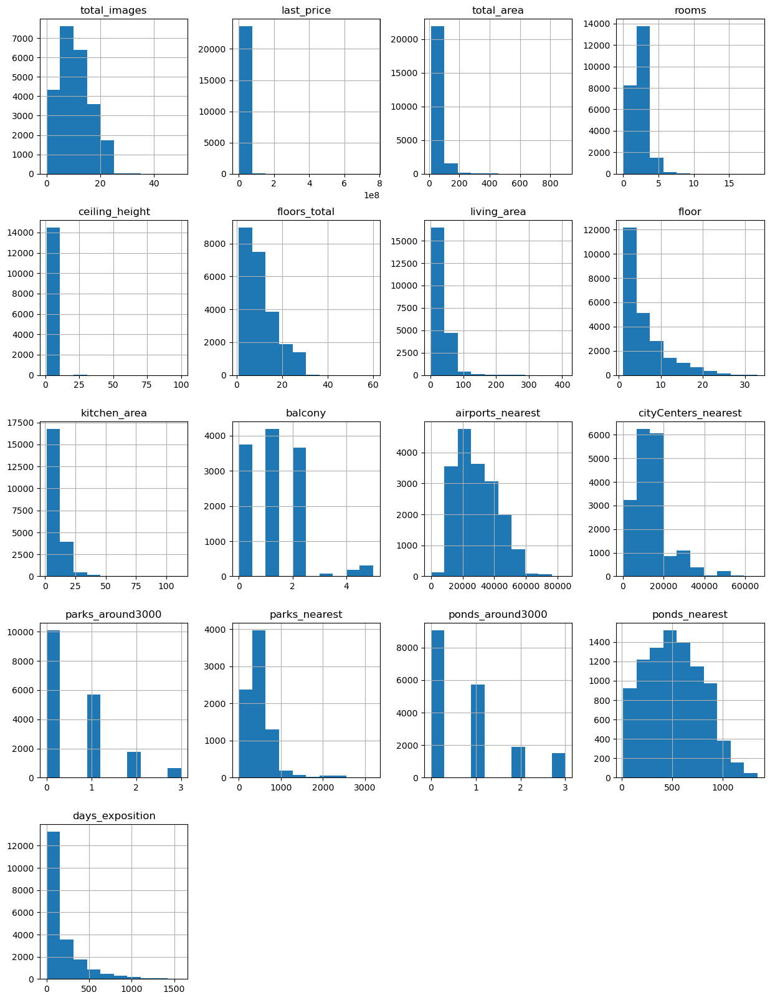

In [6]:
df.hist(figsize=(15, 20));

Также выведем общую статистику по столбцам с числовым типом данных

In [7]:
df.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23699.000000,2.369900e+04,23699.000000,23699.000000,14504.000000,23613.000000,21796.000000,23699.000000,21421.000000,12180.000000,18157.000000,18180.000000,18181.000000,8079.000000,18181.000000,9110.000000,20518.000000
mean,9.858475,6.541549e+06,60.348651,2.070636,2.771499,10.673824,34.457852,5.892358,10.569807,1.150082,28793.672193,14191.277833,0.611408,490.804555,0.770255,517.980900,180.888634
std,5.682529,1.088701e+07,35.654083,1.078405,1.261056,6.597173,22.030445,4.885249,5.905438,1.071300,12630.880622,8608.386210,0.802074,342.317995,0.938346,277.720643,219.727988
min,0.000000,1.219000e+04,12.000000,0.000000,1.000000,1.000000,2.000000,1.000000,1.300000,0.000000,0.000000,181.000000,0.000000,1.000000,0.000000,13.000000,1.000000
25%,6.000000,3.400000e+06,40.000000,1.000000,2.520000,5.000000,18.600000,2.000000,7.000000,0.000000,18585.000000,9238.000000,0.000000,288.000000,0.000000,294.000000,45.000000
50%,9.000000,4.650000e+06,52.000000,2.000000,2.650000,9.000000,30.000000,4.000000,9.100000,1.000000,26726.000000,13098.500000,0.000000,455.000000,1.000000,502.000000,95.000000
75%,14.000000,6.800000e+06,69.900000,3.000000,2.800000,16.000000,42.300000,8.000000,12.000000,2.000000,37273.000000,16293.000000,1.000000,612.000000,1.000000,729.000000,232.000000
max,50.000000,7.630000e+08,900.000000,19.000000,100.000000,60.000000,409.700000,33.000000,112.000000,5.000000,84869.000000,65968.000000,3.000000,3190.000000,3.000000,1344.000000,1580.000000


#### Вывод

Таблица данных содержит 22 столбца и 23699 строк. В качестве разделителя в csv файле выбрана табуляция. Все столбцы кроме `cityCenters_nearest` соответсвуют "хорошему стилю".  

Пропуски имеются в 14 столбцах. Особенно много пропусков в столбцах `is_apartment`, `parks_nearest`, `ponds_nearest`, `balcony`, `ceiling_height`.  

Несоответсвие типов данных. Поле `first_day_exposition` хранится в виде строки (тип object), а не в виде даты (тип datetime). Поле `is_apartment` в описании к проекту указано как булев тип, но из-за пропусков в значениях хранится как строка object. Поля `balcony`, `floors_total`, `parks_around3000`, `ponds_around3000` в которых хранится количество, должены иметь целочисленный тип int, но из-за пропусков (NaN) хранится как float.  

Есть колонки `last_price`, `ceiling_height`, `total_area`, `rooms` с аномальными значениями:
* цена на момент снятия с публикации `last_price` имеет длинный правый хвост, есть аномальные значения, квартира стоимостью 763 млн., а основная масса значений до 100 млн. 
* аналогично поля `total_area`, `ceiling_height`, где мы по гистограмме видим что большинство значений в первой группе, а остальные группы распределений практически не имеют значений.
* максимальное значение `ceiling_height` равно 100 м., минимальное значение 1 м., столбец явно имеет ошибочные значения.
* Столбец количество комнат `rooms` имеет значение 0, что также кажется странным. 
* Cтолбец жилая площадь `living_area` имеет минимальное значение 2, что очень мало для жилой площади  

На следующем этапе предобработки данных более подробнее изучим пропуски, проанализируем можно ли их заменить и чем; преобразуем типы данных; подумаем что делать с аномалиями.

### Предобработка данных

#### Переименование столбцов

In [8]:
# переименуем столбец cityCenters_nearest
df = df.rename(columns={'cityCenters_nearest':'city_сenters_nearest'})

#### Удаление пропусков

 Выведем долю и количество пропущенных значений для каждого столбца и отсортируем по убыванию.

In [9]:
df.isna().mean().sort_values(ascending=False)

is_apartment            0.882906
parks_nearest           0.659100
ponds_nearest           0.615596
balcony                 0.486054
ceiling_height          0.387991
airports_nearest        0.233850
city_сenters_nearest    0.232879
ponds_around3000        0.232837
parks_around3000        0.232837
days_exposition         0.134225
kitchen_area            0.096122
living_area             0.080299
floors_total            0.003629
locality_name           0.002068
total_images            0.000000
last_price              0.000000
studio                  0.000000
floor                   0.000000
rooms                   0.000000
first_day_exposition    0.000000
total_area              0.000000
open_plan               0.000000
dtype: float64

In [10]:
df.isna().sum().sort_values(ascending=False)

is_apartment            20924
parks_nearest           15620
ponds_nearest           14589
balcony                 11519
ceiling_height           9195
airports_nearest         5542
city_сenters_nearest     5519
ponds_around3000         5518
parks_around3000         5518
days_exposition          3181
kitchen_area             2278
living_area              1903
floors_total               86
locality_name              49
total_images                0
last_price                  0
studio                      0
floor                       0
rooms                       0
first_day_exposition        0
total_area                  0
open_plan                   0
dtype: int64

Больше всего пропусков в поле `is_apartment`, заменим пропуски на `False`, т.к. если продавец не указал ничего, то скорее всего это не аппартаменты.

In [11]:
df['is_apartment'] = df['is_apartment'].fillna('False')

Поле `balcony` заменим пропуски на 0, предположив что если продавец не указал количество балконов значит их нет.

In [12]:
df['balcony'] = df['balcony'].fillna(0)

Поле высота потолков `ceiling_height` заполним медианным значением

In [13]:
df['ceiling_height'] = df['ceiling_height'].fillna(df['ceiling_height'].median())

Поле `days_exposition` скорее всего считается автоматически в системе, и пропуски в данной колонке говорят о том, что на момент выгрузки данных, объявление еще действовало, не было снято

Попробуем заполнить пропуски в столбце жилая площадь `living_area`. Жилая площадь должна быть взаимосвязана с общей площадью. Проверим это построив scatter_matrix и таблицу корреляции.

In [14]:
px.scatter_matrix(df[['living_area', 'total_area']])

In [15]:
df[['living_area', 'total_area']].corr()

,living_area,total_area
living_area,1.000000,0.939537
total_area,0.939537,1.000000


Видим сильную линейную кореляцию жилой площади и общей площади, коэфициент корреляции 0.94. Найдем отношение общей площади к жилой для наших данных.

In [16]:
total_living = df['total_area']/df['living_area']
total_living.describe()

count    21796.000000
mean         1.846470
std          0.549462
min          1.000000
25%          1.567693
50%          1.760998
75%          2.019481
max         46.333333
dtype: float64

Для заполненея пропусков возьмем медианное значение 1.76, чтобы невелировать значение выбросов.

In [17]:
df['living_area'] = df['living_area'].fillna(df['total_area']/1.76)

Для удобства дальнейшей обработки текстового поля `locality_name` заменим пропуски в данном поле на значение `unknown`

In [18]:
df['locality_name'] = df['locality_name'].fillna('unknown')

Для остальных полей предположить логическую замену не получается, оставим пропуски в данных полях.

#### Изменение типов данных

Выведем еще раз общую информацию о датафрейме чтобы еще раз посмотреть на типы данных.

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        23699 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           23699 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          23699 non-null  object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               23699 non-null  float64
 14  locality_name         23699 non-null  object 
 15  airports_nearest   

Как уже писалось выше поля `first_day_exposition`, `balcony`, `floors_total`, `parks_around3000`, `ponds_around3000` и `is_apartment` имеют не тот тип данных.

Для последующей удобной работой с датой именно как с датой изменим тип поля `first_day_exposition` на `datetime`

In [20]:
df['first_day_exposition'] = pd.to_datetime(df['first_day_exposition'], format='%Y-%m-%dT%H:%M:%S')

In [21]:
df['balcony'].value_counts(dropna=False)

0.0    15277
1.0     4195
2.0     3659
5.0      304
4.0      183
3.0       81
Name: balcony, dtype: int64

Мы заменили все пропуски на 0 в поле `balcony`, поэтому можем сменить тип данных на `int`, причем максимальное значение балконов в квартире 5, поэтому нам даже вполне хватит `int8`

In [22]:
df['balcony'] = df['balcony'].astype('int8')

В полях `floors_total`, `parks_around3000`, `ponds_around3000` у нас остались пропуски поэтому тип данных мы изменить им не можем оставляем `float`

В поле `is_apartment` мы заменили пропуски на `False`, поэтому можем сменить тип данных на `bool`

In [23]:
df['is_apartment'] = df['is_apartment'].astype('bool')

Для уменьшения объема занимаемой памяти, можем уменьшить размерность целочисленных полей и попробовать изменить тип float на int там где позволяют данные

In [24]:
df_int = df.select_dtypes(include=['int','float'])
converted_int = df_int.apply(pd.to_numeric, downcast='integer')
df[converted_int.columns] = converted_int

Еще раз выведем общую информацию чтобы удостоверится что все нужные колонки сменили тип данных.

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   total_images          23699 non-null  int8          
 1   last_price            23699 non-null  int32         
 2   total_area            23699 non-null  float64       
 3   first_day_exposition  23699 non-null  datetime64[ns]
 4   rooms                 23699 non-null  int8          
 5   ceiling_height        23699 non-null  float64       
 6   floors_total          23613 non-null  float64       
 7   living_area           23699 non-null  float64       
 8   floor                 23699 non-null  int8          
 9   is_apartment          23699 non-null  bool          
 10  studio                23699 non-null  bool          
 11  open_plan             23699 non-null  bool          
 12  kitchen_area          21421 non-null  float64       
 13  balcony         

#### Удаление дубликатов

Проверим есть ли явные дубликаты в наших данных

In [26]:
df.duplicated().sum()

0

Явных дубликатов нет. Устраним неявные дубликаты в названиях населённых пунктов

Посмотрим сколько всего уникальных значений в колонке

In [27]:
df['locality_name'].nunique()

365

Выведем список этих значений

In [28]:
df['locality_name'].sort_values().unique()

array(['unknown', 'Бокситогорск', 'Волосово', 'Волхов', 'Всеволожск',
       'Выборг', 'Высоцк', 'Гатчина', 'Зеленогорск', 'Ивангород',
       'Каменногорск', 'Кингисепп', 'Кириши', 'Кировск', 'Колпино',
       'Коммунар', 'Красное Село', 'Кронштадт', 'Кудрово',
       'Лодейное Поле', 'Ломоносов', 'Луга', 'Любань', 'Мурино',
       'Никольское', 'Новая Ладога', 'Отрадное', 'Павловск', 'Петергоф',
       'Пикалёво', 'Подпорожье', 'Приморск', 'Приозерск', 'Пушкин',
       'Санкт-Петербург', 'Светогорск', 'Сертолово', 'Сестрорецк',
       'Сланцы', 'Сосновый Бор', 'Сясьстрой', 'Тихвин', 'Тосно',
       'Шлиссельбург', 'городской поселок Большая Ижора',
       'городской поселок Янино-1', 'городской посёлок Будогощь',
       'городской посёлок Виллози', 'городской посёлок Лесогорский',
       'городской посёлок Мга', 'городской посёлок Назия',
       'городской посёлок Новоселье', 'городской посёлок Павлово',
       'городской посёлок Рощино', 'городской посёлок Свирьстрой',
       'город

Сразу замечаем что где-то используется `е`, где-то `ё`. Заменим `ё` на `е`. Также видим что некоторые названия типов написаны по разному `поселок городского типа` и `городской поселок`; `посёлок при железнодорожной станции` и `поселок станции`; `садоводческое некоммерческое товарищество` и `садовое товарищество` приведем все к однообразию.

In [29]:
df['locality_name'] = (df['locality_name']
                       .apply(lambda x: x.replace('ё','е')
                              .replace('поселок городского типа', 'городской поселок')
                              .replace('поселок при железнодорожной станции', 'поселок станции')
                              .replace('садоводческое некоммерческое товарищество', 'садовое товарищество')
                             ))

Попробуем проверить если отбросить типы населенных пунктов, какие названия будут дублироваться.

In [30]:
# получим список всех уникальных названий
names = list(df['locality_name'].sort_values().unique())
# отбросим типы населенных пунктов
names = [n.replace('городской поселок ','').replace('деревня ','')
 .replace('коттеджный поселок ','').replace('поселок станции ','').replace('поселок ','')
 .replace('садовое товарищество ','').replace('село ','') for n in names]

from collections import Counter
names_counter = Counter(names)
# получим словарь с количеством повторений, и возмем только те, где значение больше 1
names_double = {k:v for k,v in dict(names_counter).items() if v > 1}
# выведем на экран чтобы понять что получилось
print(names_double)

{'Кудрово': 2, 'Любань': 2, 'Мурино': 2, 'Никольское': 2, 'Павлово': 2, 'Приладожский': 2, 'Рахья': 2, 'Рябово': 2, 'Федоровское': 2, 'Гарболово': 2, 'Зимитицы': 2, 'Калитино': 2, 'Рабитицы': 2, 'Щеглово': 2, 'Лесное': 2, 'Громово': 2}


Теперь выведем список уникальных названий где встречаются дубли названий, чтобы проанализировать это один и тот же населенный пункт или нет

In [31]:
# вспомогательная функция которая проверяет что в названии населенного пункта есть наш дубль из словаря names_double
def check_names_double(x):
    for name in names_double:
        if name in x:
            return True
    return False

In [32]:
# получаем уникальный список названий населенных пунктов, которые соответсвуют нашему словарю дублей 
l = df[df['locality_name'].apply(check_names_double)]['locality_name'].unique().tolist()
# отсортируем по именам населенных пунктов, чтобы было проще сравнивать
l.sort(key = lambda x: x.split()[-1])
l

['деревня Гарболово',
 'поселок Гарболово',
 'поселок станции Громово',
 'поселок Громово',
 'поселок Зимитицы',
 'деревня Зимитицы',
 'деревня Калитино',
 'поселок Калитино',
 'деревня Кудрово',
 'Кудрово',
 'поселок Лесное',
 'коттеджный поселок Лесное',
 'Любань',
 'поселок Любань',
 'поселок Мурино',
 'Мурино',
 'Никольское',
 'село Никольское',
 'село Павлово',
 'городской поселок Павлово',
 'городской поселок Приладожский',
 'садовое товарищество Приладожский',
 'деревня Рабитицы',
 'поселок Рабитицы',
 'городской поселок Рахья',
 'садовое товарищество Рахья',
 'поселок Рябово',
 'городской поселок Рябово',
 'деревня Федоровское',
 'городской поселок Федоровское',
 'поселок Щеглово',
 'деревня Щеглово']

Из полученного списка находим еще неявные дубли 'поселок Мурино' и 'Мурино'; 'деревня Кудрово' и 'Кудрово'. Остальные населенные пункты оставим как есть.

In [33]:
df['locality_name'] = (df['locality_name']
                       .replace('деревня Кудрово', 'Кудрово')
                       .replace('поселок Мурино', 'Мурино'))

In [34]:
df['locality_name'].nunique()

320

Убрав неявные дубликаты в названии населенных пунктов, сократили количество уникальных значений в колонке `locality_name` c 365 до 320

#### Устранение редких и выбивающихся значений(аномалий)

При изучении общей информации о данных мы выделили ряд полей в которых есть аномалии. `last_price`, `ceiling_height`, `total_area`, `rooms`, `living_area`. Попробуем избавится от аномалий в этих колонках.

 Начнем с высоты потолков `ceiling_height`. Выведем высоты потолков меньше 2.5 метров или выше 6 метров и посмотрим сколько таких строк.

In [35]:
df[(df['ceiling_height'] > 6) | (df['ceiling_height'] < 2.5)]['ceiling_height'].value_counts().sort_index()

1.00       1
1.20       1
1.75       1
2.00      11
2.20       1
2.25       1
2.30       4
2.34       1
2.40      23
2.45      15
2.46       2
2.47       3
2.48       8
2.49       1
8.00       3
8.30       1
10.30      1
14.00      1
20.00      1
22.60      1
24.00      1
25.00      7
26.00      1
27.00      8
27.50      1
32.00      2
100.00     1
Name: ceiling_height, dtype: int64

Высоты от 22.6 до 32 скорее всего ошиблись в разделителе. Поделим на 10 чтобы вместо 25 метров было 2.5 метра. Остальные значения выше 10 метров и ниже 2 метров их не много и они похожи на анамалии удалим их

In [36]:
df.loc[(df['ceiling_height'] >= 22.6) & (df['ceiling_height'] <= 32.0),'ceiling_height'] = df['ceiling_height']/10

In [37]:
# посмотрим сколько строк мы удаляем
len(df[(df['ceiling_height'] < 2) | (df['ceiling_height'] > 6)])

11

11 строк, это не много и не повлияет на общее распределение, удаляем.

In [38]:
df = df[(df['ceiling_height'] >= 2) & (df['ceiling_height'] <=6)]

Рассмотрим столбец `rooms` количество комнат.

Предполагаем что там где 0 комнат указано, это скорее всего 1 комната. Количество комнат взаимосвязано с жилой площадью `living_area`. Построим сводную таблицу и график, чтобы подтвердить гипотезу о том что 0 - это 1.

In [39]:
df_rooms_larea = df.groupby('rooms')['living_area'].agg(['mean', 'count']).reset_index()
df_rooms_larea

,rooms,mean,count
0,0,19.570888,197
1,1,18.268070,8042
2,2,31.790084,7936
3,3,47.321087,5812
4,4,67.023924,1180
5,5,99.873696,326
6,6,130.779160,105
7,7,166.795686,59
8,8,168.683333,12
9,9,183.165341,8


In [40]:
px.bar(df_rooms_larea, x='rooms', y='mean')

На графике прослеживается взаимосвязь количества комнат и жилой площади. Исходя из таблицы мы получили что средняя жилая площадь строк со значением комнат 0 приблизительно такая же как и строк со значением комнат 1. Что подтверждает предположение что там где в количестве комнат 0 - это 1 комната, сделаем соответсвующую замену.

In [41]:
df.loc[df['rooms'] == 0,'rooms'] = 1

Рассмотрим столбец `living_area`.

На этапе ознакомления с данными мы заметили что минимальная жилая площадь 2. Выведем данные с площадью меньшей чем $5м^2$.

In [42]:
df[df['living_area'] < 5]

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,city_сenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
3242,7,4440000,41.0,2017-07-02,1,2.65,17.0,3.0,17,True,False,False,11.0,0,Санкт-Петербург,19272.0,13073.0,0.0,NaN,0.0,NaN,216.0
13915,20,6350000,52.0,2018-02-06,2,3.00,6.0,2.0,2,True,False,False,9.0,0,Санкт-Петербург,32453.0,6521.0,0.0,NaN,1.0,1012.0,91.0
21758,0,2330000,23.0,2018-01-01,1,2.65,24.0,2.0,22,True,True,False,NaN,0,Мурино,NaN,NaN,NaN,NaN,NaN,NaN,66.0
23574,14,64990000,139.0,2015-11-24,3,3.00,8.0,3.0,8,True,False,False,16.0,1,Санкт-Петербург,33255.0,5975.0,1.0,630.0,3.0,100.0,280.0


Таких строк всего 4. Удалим данные строки.

In [43]:
df = df[df['living_area'] >= 5]

Для поиска анамалий в цене объекта `last_price` построим гистограмму

In [44]:
px.histogram(df, x='last_price', title = 'Гистограмма цены объекта', marginal = 'box')

По гистограмме видим что цена больше 100 млн. это редкие единичные случаи. Посмотрим сколько у нас объявлений с ценой больше 100 млн.

In [45]:
df[df['last_price'] > 100000000]['last_price'].count()

37

Получилось что таких значений всего 37, это меньше 0.15% от всего объема данных. Удалим строки с данными аномалиями цены

In [46]:
df = df[df['last_price'] <= 100000000]

После удаления аномально больших цен посмотрим что у нас с распределением общей площади `total_area` остались ли там аномальные значения, или они ушли вместе с аномальными ценами.

In [47]:
px.histogram(df, x='total_area', title = 'Гистограмма общей площади.', marginal = 'box')

По гистограмме видим что площадь больше 300 м2 это редкие единичные случаи. Посмотрим сколько у нас объявлений с площадь больше 300 м2.

In [48]:
df[df['total_area'] > 300]['total_area'].count()

45

Получилось что таких значений всего 45, это меньше 0.19% от всего объема данных. Удалим строки с данными аномалиями общей площадью.

In [49]:
df = df[df['total_area'] <= 300]

После удаления аномально больших цен и площадей посмотрим что у нас с данными по количеству комнат. Выше мы видили редкие случаи с 14, 15, 16, 19 комнатами, посмотрим остались ли там аномальные значения, или они ушли вместе с другими аномалиями.

In [50]:
df['rooms'].value_counts().sort_index()

1     8235
2     7934
3     5806
4     1168
5      305
6       93
7       43
8        7
9        4
10       3
11       2
14       1
16       1
Name: rooms, dtype: int64

Видим что у нас есть редкие строки с количеством комнат 14 и 16, таких строк всего 2 также удалим их.

In [51]:
df = df[df['rooms'] < 14]

Проверим сколько всего записей мы удалили, от исходного объема данных

In [52]:
df.shape[0] / 23699

0.9958226085488839

Получается мы всего удалили менее 0.4% от изначального объема.

#### Вывод

**Удаление пропусков:**
* пропуски в столбце `is_apartment` заполнили значением `False`, т.к. скорее всего если продавец явно не указал что это апартамены, то это не апартаменты.
* пропуски в столбце `balcony` заполнили 0, предположив что если продавец не указал количество балконов значит их нет.
* пропуски в столбце `ceiling_height` заполнили медианным значением `ceiling_height`.
* Жилая площадь `living_area` сильно корелирует с общей площадью `total_area`. Коэфициент корреляции 0.94, поэтому пропуски в жилой площади заполнили исходя из данных общей площади.
* Поле `days_exposition` скорее всего заполняется автоматически в системе, при снятии объявления, и пропуски в данной колонке говорят о том, что на момент выгрузки данных, объявление еще действовало, не было снято.
* Для удобства дальнейшей обработки текстового столбца `locality_name` заменили пропуски в данном столбце на значение `unknown`  
  
Для остальных полей предположить логическую замену не получается, оставим пропуски в данных полях. Причина пропусков в пользовательских типах данных, может быть человеческий фактор, продавец просто не указал какие-то данные посчитав их не важными. Пропуски в картографических типах данных может говорить о том что таких данных нет. Например расстояния до ближайшего парка - поблизости нет парков и поэтому нет возможности указать растояние до них. Или произошли ошибки при их загрузки, на это косвенно указывает, то что пропуски в этих столбцах относятся к одним и тем же строкам. 

**Изменение типов данных:**
* Столбец `is_apartment`, после замены NаN, на False преобразовали к типу `bool`
* Столбец дата публикации `first_day_exposition` к типу `datetime64`
* Столбцы `total_images`, `last_price`, `rooms`, `floor`, `balcony` к `int` и привели размерность `int` в соответсвии с набором данных которые хранятся в данных колонках. Интересное наблюдение т.к. `last_price` исходя из набора данных которые в нем хранятся сменил тип на int, то значит все цены указанны в целых еденицах без копеек.

**Удаление дубликатов.**  
Явных дубликатов в таблице нет. Убрали неявные дубликаты в названии населенных пунктов `locality_name`. Сократили количество уникальных значений в колонке `locality_name` c 365 до 320.

**Устранение редких и выбивающихся значений(аномалий):**
* устранены аномалии в столбце `ceiling_height`. Высоты от 22.6 до 32 предположительно образовались из-за ошибки разрядности, поэтому поделили их на 10 чтобы вместо 25 метров было 2.5 метра. Остальные строки выше 10 метров и ниже 2 метров удалили, всего таких строк 11.
* в столбце `rooms` 0 заменили на 1. Проведя анализ и установя, что среднее значение жилой площади в этих строках равно 18.8, а это соответсвует как раз строкам где количество комнат 1.
* удалили строки с очень маленькой жилой площадью `living_area` 2 и 3 $м^2$. Всего таких строк 4.
* удалили строки с ценой `last_price` выше 100 млн. по гистограмме мы видим что такие значения очень редки и сильно выбиваются из общего распределения. Всего таких значений 37 строк, это меньше 0.15% от всего объема данных.
* удалили строки с общей площадью `total_area` больше 300 м2 по гистограмме мы видим что такие значения очень редки и сильно выбиваются из общего распределения. Всего таких значений 45 строк, это меньше 0.19% от всего объема данных.
* удалили строки с количеством комнат 14 и 16, эти значения очень редки, всего таких строк 2  
Всего мы удалили аномальных значений меньше 0.4% от изначального объема данных.

### Посчитайте и добавьте в таблицу новые столбцы

#### Цена одного квадратного метра

In [53]:
df['price_square_meter'] = (df['last_price']/df['total_area']).round(2)

#### день недели публикации объявления (0 — понедельник, 1 — вторник и так далее)

In [54]:
df['weekday_exposition'] = pd.DatetimeIndex(df['first_day_exposition']).weekday

#### месяц публикации объявления

In [55]:
df['month_exposition'] = pd.DatetimeIndex(df['first_day_exposition']).month

#### год публикации объявления

In [56]:
df['year_exposition'] = pd.DatetimeIndex(df['first_day_exposition']).year

#### тип этажа квартиры (значения — «первый», «последний», «другой»);

In [57]:
#функция которая по этажу и кол-ву этажей поделит на 'первый', 'последний', 'другой'
def type_floor(row):
    if row['floor'] == 1:
        return 'первый'
    if row['floor'] == row['floors_total']:
        return 'последний'
    return 'другой'

In [58]:
df['type_floor'] = df.apply(type_floor, axis=1)

#### расстояние до центра города в километрах

In [59]:
df['city_сenters_nearest_km'] = (df['city_сenters_nearest']/1000).round(0)

#### Вывод

Рассчитаны и добавлены новые признаки:
* цена одного квадратного метра;
* день недели публикации объявления;
* месяц публикации объявления;
* год публикации объявления;
* тип этажа квартиры ('первый', 'последний', 'другой');
* расстояние до центра города в километрах.

### Проведите исследовательский анализ данных

#### Изучение параметров объектов

##### Площади: общая площадь - `total_area`, жилая площадь - `living_area`, площадь кухни - `kitchen_area`

In [60]:
df['total_area'].describe()

count    23600.000000
mean        59.287097
std         30.050891
min         12.000000
25%         40.000000
50%         52.000000
75%         69.300000
max        300.000000
Name: total_area, dtype: float64

In [61]:
px.histogram(df, x='total_area', title = 'Гистограмма общей площади', marginal = 'box')

Распределение имеет длинный правый хвост. По гистограмме и boxplot видим что основной объем квартир до 115 м2. Для более детального изучения построим гистограмму в диапазоне (0, 120)

In [62]:
px.histogram(df[df['total_area']<120], x='total_area', title = 'Гистограмма общей площади в диапазоне 0-120', nbins=60)

На гистограмме видим что больше всех объявлений в диапазоне от 30 до 48 м2, второй блок от 50 до 66, третий блок от 70 до 80, далее мы видим более плавное снижение без всплесков. Предположительно это связано с типовыми застройками, 1,2,3 - x комнатные квартиры часто имеют стандартные площади, что мы и наблюдаем в виде пиков. Больше всего 1458 квартир с площадью в диапазоне [44, 46).

In [63]:
df['living_area'].describe()

count    23600.000000
mean        33.984862
std         19.458395
min          5.000000
25%         19.000000
50%         30.000000
75%         42.000000
max        250.000000
Name: living_area, dtype: float64

In [64]:
px.histogram(df, x='living_area', title = 'Гистограмма жилой площади', marginal = 'box')

Картина пожожа на гистограмму общей площади. Но с более ярко выраженными группами, на которых мы можем видить 1,2,3- комнатные квартиры, т.к. жилаю площадь еще больше взаимосвязана с количеством комнат. Наблюдаем три ярких пика [17.5, 18.5), [29.5, 30.5), [42.5, 43.5)

Посмотрим на распределение доли жилой площади от общей

In [65]:
df['living_to_total'] = df['living_area']/df['total_area']

In [66]:
px.histogram(df, x='living_to_total', title = 'Доля жилой площади от общей', marginal = 'box', nbins=10, histnorm='percent')

Как мы уже видели ранее при заполнении пропусков в `living_area` в большинстве жилая площадь занимает 0.56 общей площади квартиры. А если рассматривать диапазон от 0.45 до 0.65 то это около 67% всех объявлений.

In [67]:
df['kitchen_area'].describe()

count    21340.000000
mean        10.486306
std          5.618767
min          1.300000
25%          7.000000
50%          9.100000
75%         12.000000
max        107.000000
Name: kitchen_area, dtype: float64

In [68]:
px.histogram(df, x='kitchen_area', title = 'Гистограмма площади кухни', marginal = 'box')

Основная часть квартир имеет кухни от 7 до 12 м2. Также как и на гистограммах общей и жилой площади имеется очень длинный правый хвост.

Также посмотрим на распределение доли площади кухни от общей

In [69]:
df['kitchen_to_total'] = df['kitchen_area']/df['total_area']

In [70]:
px.histogram(df, x='kitchen_to_total', title = 'Доля площади кухни от общей', marginal = 'box', nbins=10, histnorm='percent')

Доля площади кухни от общей площади в основном 0.1-0.2

##### Цена объекта

In [71]:
df['last_price'].describe()

count    2.360000e+04
mean     6.166905e+06
std      6.057759e+06
min      1.219000e+04
25%      3.400000e+06
50%      4.600000e+06
75%      6.750000e+06
max      9.900000e+07
Name: last_price, dtype: float64

In [72]:
px.histogram(df, x='last_price', title = 'Гистограмма цены', marginal = 'box')

Cильные выбросы цены не позволяют хорошо изучить данные. Согласно боксплот Q3+1.5IQR равен 11.9 млн. все остальное можно считать выбросами. Для более хорошего узучения данных построим гистогламму в диапозоне до 15 млн.

In [73]:
px.histogram(df[df['last_price'] < 15000000], 
             x='last_price', 
             title = 'Гистограмма цены в диапазоне до 15 млн.', 
             marginal = 'box',
            nbins = 50)

Основная масса объявлений в диапазоне от 3.35 до 6.3 млн. Наибольшее количество 2656 шт. в диапазоне 3.5-4 млн.

##### Количество комнат

In [74]:
df['rooms'].describe()

count    23600.000000
mean         2.064449
std          1.023578
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         11.000000
Name: rooms, dtype: float64

In [75]:
px.histogram(df, x='rooms', 
             title = 'Гистограмма количество комнат', 
             marginal = 'box')

Основная масса объявлений это 1,2-х комнатные квартиры примерно по 8000 объявлений, 3-х комнатных квартир - 5806. 4-x комнатных и дальше существенно меньше.

##### Высота потолков

In [76]:
df['ceiling_height'].describe()

count    23600.000000
mean         2.694922
std          0.214841
min          2.000000
25%          2.600000
50%          2.650000
75%          2.700000
max          5.800000
Name: ceiling_height, dtype: float64

In [77]:
px.histogram(df, x='ceiling_height', 
             title = 'Гистограмма высоты потолков', 
             marginal = 'box')

Основная масса квартир 9840 имеет высоту потолков 2.65 м, но причина такого пика из-за того что мы все пропуски в высоте потолков, а это 9195 наблюдений заполнили медианным значением 2.65м. 99% объектов имеет высоту потолков в диапазоне от 2.5 до 3 метров.

##### Этаж квартиры

In [78]:
df['floor'].describe()

count    23600.000000
mean         5.894068
std          4.886999
min          1.000000
25%          2.000000
50%          4.000000
75%          8.000000
max         33.000000
Name: floor, dtype: float64

In [79]:
px.histogram(df, x='floor', 
             title = 'Гистограмма этаж квартиры', 
             marginal = 'box')

Видим практически одинаковое количество предложений больше 2500 на каждый этаж с 1 по 5 этаж, и это больше половины всех предложений. Далее видим резкий скачек вниз практически но 50% между предложением 5 и 6 этажа. Это говорит о том что в Санкт-Петербурге и области малоэтажная застройка до 5 этажей, и предложений многоэтажных зданий не так много. Но небоскребы в городе есть максимальный этаж предложения - 33.

##### Тип этажа квартиры («первый», «последний», «другой»)

In [80]:
df['type_floor'].value_counts()

другой       17390
последний     3302
первый        2908
Name: type_floor, dtype: int64

In [81]:
px.histogram(df, x='type_floor', title = 'Гистограмма тип этажа', histnorm='probability density')

В основном все предложения не на первом и не на последнем этаже. На первом и на последнем этаже предложений 12% и 14% соответсвенно.

##### Общее количество этажей в доме

In [82]:
df['floors_total'].describe()

count    23514.000000
mean        10.687208
std          6.598260
min          1.000000
25%          5.000000
50%          9.000000
75%         16.000000
max         60.000000
Name: floors_total, dtype: float64

In [83]:
px.histogram(df, x='floors_total', 
             title = 'Гистограмма общее количество этажей', 
             marginal = 'box')

Наше предположение о малоэтажной застройке подтверждается и на этой гистограмме. Большинство предложений в 5 этажных домах - 5773. Довольно большое количество предложений в 9 этажных домах - 3756. Далее видим примерно одинаковые пики выше 1000 в 12, 16 и 25 этажных домах. Есть небоскребы в 52 и 60 этажей.

##### Расстояние до центра города в метрах

In [84]:
df['city_сenters_nearest'].describe()

count    18086.000000
mean     14225.136570
std       8603.748491
min        181.000000
25%       9289.000000
50%      13123.000000
75%      16300.000000
max      65968.000000
Name: city_сenters_nearest, dtype: float64

In [85]:
px.histogram(df, x='city_сenters_nearest', 
             title = 'Гистограмма расстояние до центра города', 
             marginal = 'box', nbins = 50)

Основная масса предложений находится на расстоянии 9-16 км от центра. Также довольно хороший всплеск квартир на расстоянии 4-6 км.

##### Расстояние до ближайшего аэропорта

In [86]:
df['airports_nearest'].describe()

count    18065.000000
mean     28804.843343
std      12651.164462
min          0.000000
25%      18557.000000
50%      26757.000000
75%      37310.000000
max      84869.000000
Name: airports_nearest, dtype: float64

In [87]:
px.histogram(df, x='airports_nearest', 
             title = 'Гистограмма расстояние до ближайшего аэропорта', 
             marginal = 'box', nbins = 50)

##### Расстояние до ближайшего парка

In [88]:
df['parks_nearest'].describe()

count    8014.000000
mean      491.129274
std       342.729853
min         1.000000
25%       288.000000
50%       455.000000
75%       612.000000
max      3190.000000
Name: parks_nearest, dtype: float64

In [89]:
px.histogram(df, x='parks_nearest', 
             title = 'Гистограмма расстояние до ближайшего парка', 
             marginal = 'box', nbins = 50)

У нас много пропусков в столбце `parks_nearest` 66% данных не заполнено. Но среди тех которых заполнено, в основном парк находится очень близко не далее 700 метров. А для 99% заполненых данных парк находится на расстоянии не далее 1 км.

##### День и месяц публикации объявления

In [90]:
px.histogram(df['weekday_exposition'],
             title = 'Гистограмма день недели публикации объявления', 
             marginal = 'box')

In [91]:
px.histogram(df, x='month_exposition', 
             title = 'Гистограмма месяц публикации объявления', 
             marginal = 'box')

Наиболее популярные месяцы для подачи объявлений февраль, март более 2500. Наименее популярны май, январь - 1273 и 1499 соответсвенно. По дням недели в будни количество объявлений примерно одинаковое, а в выходные в 2 раза меньше, скорее всего это связано с режимом работы агентств недвижимости, в выходные многие не работают и поэтому нет новых объявлений в эти дни.

#### Изучите, как быстро продавались квартиры

Изучим, как быстро продавались квартиры (столбец `days_exposition`). Этот параметр показывает, сколько дней было размещено каждое объявление. 

In [92]:
df['days_exposition'].describe()

count    20435.000000
mean       180.483240
std        219.393497
min          1.000000
25%         45.000000
50%         95.000000
75%        231.000000
max       1580.000000
Name: days_exposition, dtype: float64

In [93]:
px.histogram(df, x='days_exposition', 
             title = 'Гистограмма продолжительности дней размещения объявления', 
             marginal = 'box',
             nbins = 200)

Среднее значение `days_exposition` 180.48 дней, а медиана почти в 2 раза меньше 95 дней, что говорит о редких очень больших значениях, что мы наглядно видим на боксплоте и гистограмме. Согласно боксплоту 99% данных лежит в диапазоне от 0 до 510, Q1 = 45, Q3 = 231, все что больше 510 дней можно считать выбросами, необычно долгими продажами. По гистограмме видим что чаще всего квартиры продаются в течение 40 - 50 дней - 1723 квартир проданы в течение этого периода. Около 15% квартир продается за первые 30 дней, причем мы видим практически равные распределения каждые 10 дней. За первые 10 дней - 1127, с 10 по 19 - 1232, с 20 по 29 - 1158. Распределение имеет очень длинный "хвост". Максимальная продолжительность продажи составила 1580 дней, больше 4-х лет.

In [94]:
px.histogram(df[df['days_exposition'] <=100], x='days_exposition', 
             title = 'Гистограмма продолжительности дней размещения объявления, в диапазоне от 0 до 100 дней', 
             marginal = 'box')

#### Какие факторы больше всего влияют на общую (полную) стоимость объекта

Изучим, зависит ли цена от:
* общей площади;
* жилой площади;
* площади кухни;
* количества комнат;
* этажа, на котором расположена квартира (первый, последний, другой);
* даты размещения (день недели, месяц, год).  
  

Для начала изучим взаимосвязь цены и площадей: общей, жилой, кухни.

In [95]:
df[['last_price', 'total_area', 'living_area', 'kitchen_area']].corr()

,last_price,total_area,living_area,kitchen_area
last_price,1.000000,0.755057,0.666593,0.581843
total_area,0.755057,1.000000,0.938353,0.583873
living_area,0.666593,0.938353,1.000000,0.376673
kitchen_area,0.581843,0.583873,0.376673,1.000000


Построим диаграммы рассеяния цены и площадей.

In [96]:
px.scatter(df, 
           x='total_area', 
           y='last_price', 
           trendline='ols', 
           title = 'Диаграмма рассеяния цены и общей площади')

In [97]:
px.scatter(df, 
           x='living_area', 
           y='last_price', 
           trendline='ols', 
           title = 'Диаграмма рассеяния цены и жилой площади')

In [98]:
px.scatter(df, 
           x='kitchen_area', 
           y='last_price', 
           trendline='ols', 
           title = 'Диаграмма рассеяния цены и площади кухни')

Между ценой и общей площадью наблюдается достаточно сильная положительная корреляция коэффициент кореляции - 0.76, она же сохранятся между ценой и жилой площадью - 0.67, а вот между ценой и площадью кухни взаимосвязь уже не такая сильная, но тоже присутствует - 0.58.

Для определения взаимосвязи между ценой и категориальными признаками количества комнат, типа этажа, даты размещения (день недели, месяц, год) расчитаем среднее и медиану для каждой категории и по ним построим графики.

In [99]:
rooms_last_price_mean_median = df.groupby('rooms')['last_price'].agg(['mean', 'median']).reset_index()
rooms_last_price_mean_median

,rooms,mean,median
0,1,3.809142e+06,3584000.0
1,2,5.556252e+06,4770000.0
2,3,8.028566e+06,6200000.0
3,4,1.238024e+07,9000000.0
4,5,1.796835e+07,13180000.0
5,6,2.310241e+07,17500000.0
6,7,2.370907e+07,22000000.0
7,8,2.054143e+07,18000000.0
8,9,2.306250e+07,23125000.0
9,10,2.616667e+07,23000000.0


In [100]:
px.bar(data_frame = rooms_last_price_mean_median,
       x = 'rooms',
       y = ['median', 'mean'],
       barmode = 'group', 
       title = 'Диаграмма средней и медианной цены квартиры от количества комнат')

По сводной таблице и по графику видим как с увеличением количества комнат от 1 до 7 цена растет, при дальнейшем увеличении количества комнат рост уже не такой стримительный.

In [101]:
type_floor_last_price_mean_median = df.groupby('type_floor')['last_price'].agg(['mean', 'median']).reset_index()
type_floor_last_price_mean_median

,type_floor,mean,median
0,другой,6.424946e+06,4800000.0
1,первый,4.678171e+06,3900000.0
2,последний,6.119027e+06,4300000.0


In [102]:
px.bar(data_frame = type_floor_last_price_mean_median,
       x = 'type_floor',
       y = ['median', 'mean'],
       barmode = 'group', 
       title = 'Диаграмма средней и медианной цены квартиры от типа этажа'
      )

Цены на первом этаже ниже остальных этажей, на последнем этаже также ниже чем на "других".

In [103]:
weekday_last_price_mean_median = df.groupby('weekday_exposition')['last_price'].agg(['mean', 'median']).reset_index()
weekday_last_price_mean_median

,weekday_exposition,mean,median
0,0,6.174366e+06,4648500.0
1,1,6.126013e+06,4700000.0
2,2,6.145686e+06,4700000.0
3,3,6.410669e+06,4600000.0
4,4,6.122069e+06,4550000.0
5,5,6.008669e+06,4540000.0
6,6,5.971010e+06,4550000.0


In [104]:
px.bar(data_frame = weekday_last_price_mean_median,
       x = 'weekday_exposition',
       y = ['median', 'mean'],
       barmode = 'group', 
       title = 'Диаграмма средней и медианной цены квартиры от дня недели размещения объявления'
      )

In [105]:
month_last_price_mean_median = df.groupby('month_exposition')['last_price'].agg(['mean', 'median']).reset_index()
month_last_price_mean_median

,month_exposition,mean,median
0,1,6.311072e+06,4600000.0
1,2,6.209993e+06,4650000.0
2,3,5.976613e+06,4650000.0
3,4,6.066430e+06,4800000.0
4,5,6.207571e+06,4500000.0
5,6,6.077876e+06,4400000.0
6,7,6.182268e+06,4625000.0
7,8,6.109507e+06,4555000.0
8,9,6.286033e+06,4690000.0
9,10,5.871485e+06,4550000.0


In [106]:
px.bar(data_frame = month_last_price_mean_median,
       x = 'month_exposition',
       y = ['median', 'mean'],
       barmode = 'group', 
       title = 'Диаграмма средней и медианной цены квартиры от месяца размещения объявления'
      )

Зависимости цены от дня недели и месяца подачи объявления нет.

In [107]:
year_last_price_mean_median = df.groupby('year_exposition')['last_price'].agg(['mean', 'median']).reset_index()
year_last_price_mean_median

,year_exposition,mean,median
0,2014,1.208714e+07,7700000.0
1,2015,7.629730e+06,5300000.0
2,2016,6.363752e+06,4500000.0
3,2017,6.086542e+06,4500000.0
4,2018,5.787845e+06,4550000.0
5,2019,6.445021e+06,5045000.0


In [108]:
px.bar(data_frame = year_last_price_mean_median,
       x = 'year_exposition',
       y = ['median', 'mean'],
       barmode = 'group', 
       title = 'Диаграмма средней и медианной цены квартиры от года размещения объявления'
      )

Наибольшая стоимость квартир была в 2014 году, в 2015 году стоимость квартир сильно упала, в 2016 год также было небольшое снижение по сравнению с 2015 годом, далее цены примерно на одном уровне. В 2019 году наметилсяя небольшой рост, цены вернулись на уровень 2015 года.

#### Посчитайте среднюю цену одного квадратного метра

Посчитаем среднюю цену одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений.

In [109]:
#определим топ 10 населенных пунктов по количеству объявлений
top10_locality_exposition = df['locality_name'].value_counts().head(10).index
top10_locality_exposition

Index(['Санкт-Петербург', 'Мурино', 'Кудрово', 'поселок Шушары', 'Всеволожск',
       'Пушкин', 'Колпино', 'поселок Парголово', 'Гатчина', 'Выборг'],
      dtype='object')

In [110]:
top10_price_square_meter = (df.query('locality_name in @top10_locality_exposition')
                              .groupby('locality_name')['price_square_meter']
                              .mean()
                              .sort_values(ascending=False))
top10_price_square_meter

locality_name
Санкт-Петербург      113510.270846
Пушкин               103130.851826
Кудрово               95324.930508
поселок Парголово     90175.913089
Мурино                86061.676978
поселок Шушары        78677.364318
Колпино               75333.295816
Гатчина               68746.146515
Всеволожск            68654.473970
Выборг                58141.909325
Name: price_square_meter, dtype: float64

Выделем населённые пункты с самой высокой и низкой стоимостью квадратного метра.

In [111]:
top10_price_square_meter.index[0]


'Санкт-Петербург'

In [112]:
top10_price_square_meter.index[-1]

'Выборг'

Из топ 10 населенных пунктов по количеству объявлений самая высокая стоимость квадратного метра в Санкт-Петербурге в размере 113510.27; cамая низкая стоимость квадратного метра в Выборге - 58141.91.

In [113]:
px.bar(data_frame = top10_price_square_meter.reset_index(),
       x = 'locality_name',
       y = 'price_square_meter',
       title = 'Диаграмма топ 10 по средней цене'
      )

#### Как стоимость объектов зависит от расстояния до центра города

Выберем квартиры в Санкт-Петербурге и вычислим среднюю цену каждого километра.

In [114]:
 last_price_сenters_nearest_km = (df[df['locality_name'] == 'Санкт-Петербург']
                                    .groupby('city_сenters_nearest_km')['last_price']
                                    .mean()
                                    .reset_index())
last_price_сenters_nearest_km    

,city_сenters_nearest_km,last_price
0,0.0,2.654331e+07
1,1.0,1.579466e+07
2,2.0,1.441889e+07
3,3.0,1.066658e+07
4,4.0,1.131852e+07
5,5.0,1.246750e+07
6,6.0,1.304900e+07
7,7.0,1.380374e+07
8,8.0,9.134497e+06
9,9.0,6.950659e+06


In [115]:
px.bar(last_price_сenters_nearest_km, 
        x="city_сenters_nearest_km", 
        y="last_price", 
        title='Средняя цена квартиры в зависимости от расстояния от центра')

Чем дальше от центра тем ниже цена квартиры. В районе 7-9 километра видим резкое снижение цены, это граница центра города. В районе 27 км видим всплеск цены. Посмотрим чем именно обусловлен всплеск на этом километре. 

In [116]:
df[(df['locality_name'] == 'Санкт-Петербург') & (df['city_сenters_nearest_km'] == 27)]

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,city_сenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_square_meter,weekday_exposition,month_exposition,year_exposition,type_floor,city_сenters_nearest_km,living_to_total,kitchen_to_total
748,13,14350000,74.0,2017-11-28,2,3.13,5.0,30.0,3,True,False,False,25.0,0,Санкт-Петербург,23888.0,27313.0,1.0,1496.0,0.0,NaN,128.0,193918.92,1,11,2017,другой,27.0,0.405405,0.337838
5961,6,2250000,32.0,2018-02-27,1,2.65,2.0,16.5,2,True,False,False,7.0,0,Санкт-Петербург,24006.0,27431.0,0.0,NaN,0.0,NaN,178.0,70312.50,1,2,2018,последний,27.0,0.515625,0.218750


На 27 км у нас всего 2 предложения и одно из них с ценой 14.3 млн. и стоймостью кв.м. 193918, возможно в этом районе есть элитная застройка, которая пораждает это всплеск цены на нашем графике.

#### Вывод

В процессе иследовательского анализа данных мы изучили параметры объектов:
* **общая площадь** Распределение общей площади имеет длинный правый "хвост". По боксплоту и гистограмме видим что основная масса предложений - это квартиры до 115 м2. Больше всего квартир в диапазоне от 30 до 48 м2, второй блок от 50 до 66, третий блок от 70 до 80, далее мы видим более плавное снижение количество предложений без всплесков. Предположительно это связано с типовыми застройками, 1,2,3 - x комнатные квартиры часто имеют стандартные площади, что мы и наблюдаем в виде пиков. Больше всего 1458 квартир с площадью в диапазоне от 44 до 46 м2.
* **жилая площадь** Картина распределения жилой площади схожа с общей площадью, здесь более ярко выделюится группы 1,2,3- комнатных квартиры. Наблюдаем три ярких пика предложений в диапазоне от 17.5 до 18.5; от 29.5 до 30.5; от 42.5 до 43.5. В большинстве квартир жилая площадь занимает 0.56 от общей площади квартиры.
* **площадь кухни** Основная часть квартир имеет кухни от 7 до 12 м2. Также как и на гистограммах общей и жилой площади имеется очень длинный правый хвост. Доля площади кухни от общей площади в основном 0.1-0.2.
* **цена объекта** В цене квартир мы имеем сильные выбросы, еще на этапе предобработки данных, мы избавились от самых явных аномалий и оставили цены до 100 млн. Согласно графика боксплот Q3+1.5IQR равен 11.9 млн. все остальное можно считать выбросами. Основная масса объявлений в диапазоне от 3.35 до 6.3 млн. Наибольшее количество 2656 шт. в диапазоне 3.5-4 млн.
* **количество комнат** Основная масса объявлений это 1,2-х комнатные квартиры примерно по 8000 объявлений, 3-х комнатных квартир - 5806. 4-x комнатных и дальше существенно меньше.
* **высота потолков** Большинство квартир 9840 имеет высоту потолков 2.65 м, но причина такого пика из-за того что мы все пропуски в высоте потолков, а это 9195 наблюдений заполнили медианным значением 2.65м. Более 99% от всех объявлений имеет высоту потолков в диапазоне от 2.5 до 3 метров.
* **этаж квартиры** Наблюдаем практически равное количество предложений больше 2500 на каждый этаж с 1 по 5 этаж, и это больше половины всех предложений. Далее видим резкий спад на 50% между количеством предложений на 5 и 6 этажа. Это говорит о том что в Санкт-Петербурге и области малоэтажная застройка до 5 этажей, и предложений многоэтажных зданий не так много. Но небоскребы в городе есть максимальный этаж предложения - 33.
* **тип этажа квартиры** В основном все предложения не на первом и не на последнем этаже. Предложений на первом и на последнем этаже 12% и 14% соответсвенно.
* **общее количество этажей** Данный параметр также подтверждает предположение о малоэтажной застройке. Большинство предложений в 5 этажных домах - 5773. Довольно большое количество предложений в 9 этажных домах - 3756. Далее видим примерно одинаковые пики выше 1000 в 12, 16 и 25 этажных домах. Есть небоскребы в 52 и 60 этажей.
* **расстояние до центра города** Основная масса предложений находится на расстоянии 9-16 км от центра.
* **расстояние до ближайшего парка** У нас много пропусков в столбце parks_nearest 66% данных не заполнено. Но среди тех предложений где заполнено, в 86% предложений парк находится очень близко не более 700 метров. А для 99% заполненых данных парк находится на расстоянии не более 1 км.
* **день и месяц публикации объявления** Наиболее популярные месяцы для подачи объявлений февраль, март. Наименее популярны май, январь. По дням недели в будни количество объявлений примерно одинаковое, а в выходные в 2 раза меньше, скорее всего это связано с режимом работы агентств недвижимости, в выходные многие не работают и поэтому нет новых объявлений в эти дни.

Около 15% квартир продается за первые 30 дней, причем мы видим практически равные распределения каждые 10 дней. За первые 10 дней - 1127, с 10 по 19 - 1232, с 20 по 29 - 1158. 50% квартир продается за 95 дней. Все что продается дольше 510 дней можно считать выбросами, необычно долгими продажами. Максимальная продолжительность продажи составила 1580 дней, больше 4-х лет.

Больше всего на цену влияет общая площадью коэфициент кореляции 0.76. Также мы видем зависимость от количества комнат, чем больше комнат тем выше цена, в диапазоне до 7 комнат мы наблюдаем стремительный рост цены, при дальнейшем увеличении количества комнат рост уже не такой стримительный. Снижают цену квартиры расположенные на первом этаже, на последнем этаже квартиры тоже дешевле, но не так сильно как на первом.

Из топ 10 населенных пунктов по количеству объявлений самая высокая средняя стоимость квадратного метра в Санкт-Петербурге в размере 113510.27; cамая низкая средняя стоимость квадратного метра в Выборге - 58141.91.

В Санкт-Петербурге чем дальше от центра тем ниже цена квартиры. В районе 7-9 километров от центра видим резкое снижение цены, это граница центра города.


### Общий вывод

В нашем распоряжении архив объявлений за несколько лет о продаже квартир в Санкт-Петербурге и соседних населённых пунктах. Необходимо найти интересные особенности и зависимости, которые существуют на рынке недвижимости.

Таблица данных содержит 22 столбца и 23699 строк. В 14 столбцах имеются пропуски. Особенно много пропусков в столбцах является ли квартира апартаментами (`is_apartment`), расстояние до ближайшего парка (`parks_nearest`), расстояние до ближайшего водоема (`ponds_nearest`), количество балконов (`balcony`), высота потолков (`ceiling_height`).

**На этапе предобработки данных:**
* там где это возможно заменили пропуски. В столбце `is_apartment` заменили на значение `False`, скорее всего если продавец явно не указал что это апартамены, то это не апартаменты. В столбце `balcony` заменили на 0, предположив что если продавец не указал количество балконов значит их нет. В столбце `ceiling_height` заменили на медианное значение `ceiling_height`. Жилая площадь `living_area` сильно корелирует с общей площадью `total_area`. Коэфициент корреляции 0.94, поэтому пропуски в жилой площади заполнили исходя из данных общей площади. Причина пропусков в пользовательских типах данных, может быть человеческий фактор, продавец просто не указал какие-то данные посчитав их не важными. 
* удалили неявные дубликаты в названии населенных пунктов `locality_name`, тем самым сократили количество уникальных значений в колонке `locality_name` c 365 до 320.
* устранили аномалии в данных. В столбце `ceiling_height` высоты от 22.6 до 32 предположительно образовались из-за ошибки разрядности, поэтому поделили их на 10 чтобы вместо 25 метров было 2.5 метра. Оставшиеся строки со значениями выше 10 метров и ниже 2 метров удалили, всего таких строк было 11. В столбце `rooms` 0 заменили на 1, посчитали среднее значение жилой площади в строках с `rooms` = 0  получили 18.8 м2, а это соответсвует жилой площади для строк где количество комнат 1. Удалили редкие и аномальные значения: строки с очень маленькой жилой площадью 2 и 3 $м^2$; с ценой квартиры выше 100 млн.; с общей площадью выше 300 $м^2$; с количеством комнат 14 и 16. Всего из-за аномалий удалили 99 записей, это меньше 0.4% от изначального объема данных.

**В процессе иследовательского анализа данных:**  
Изучили параметры объектов, посчитали статистические характеристики параметров.  
Нашли следующие особенности и зависимости:  
* **Как быстро продавались квартиры?**  
Около 15% квартир продается за первые 30 дней, причем мы видим практически равные распределения каждые 10 дней. За первые 10 дней - 1127, с 10 по 19 - 1232, с 20 по 29 - 1158. 50% квартир продается за 95 дней. Все что продается дольше 510 дней можно считать выбросами, необычно долгими продажами. Максимальная продолжительность продажи составила 1580 дней, больше 4-х лет.
* **Какие факторы больше всего влияют на стоимость?**  
Больше всего на цену влияет общая площадь, коэфициент кореляции 0.76. Также мы видем зависимость от количества комнат, чем больше комнат тем выше цена, в диапазоне до 7 комнат мы наблюдаем стремительный рост цены, при дальнейшем увеличении количества комнат рост уже не такой стримительный. Снижает цену квартиры расположение её на первом этаже, на последнем этаже квартиры также дешевле, но не так сильно как на первом.
* **Средняя цена одного квадратного метра.**  
Из топ 10 населенных пунктов по количеству объявлений самая высокая средняя стоимость квадратного метра в Санкт-Петербурге в размере 113510.27; cамая низкая средняя стоимость квадратного метра в Выборге - 58141.91.
* **Как стоимость объектов зависит от расстояния до центра города**  
В Санкт-Петербурге чем дальше от центра тем ниже цена квартиры. В районе 7-9 километров от центра видим резкое снижение цены, это граница центра города.


**Чек-лист готовности проекта**

Поставьте 'x' в выполненных пунктах. Далее нажмите Shift+Enter.

- [x]  открыт файл
- [x]  файлы изучены (выведены первые строки, метод `info()`, гистограммы и т.д.)
- [x]  определены пропущенные значения
- [x]  заполнены пропущенные значения там, где это возможно
- [x]  есть пояснение, какие пропущенные значения обнаружены
- [x]  изменены типы данных
- [x]  есть пояснение, в каких столбцах изменены типы и почему
- [x]  устранены неявные дубликаты в названиях населённых пунктов
- [x]  устранены редкие и выбивающиеся значения (аномалии) во всех столбцах
- [x]  посчитано и добавлено в таблицу: цена одного квадратного метра
- [x]  посчитано и добавлено в таблицу: день публикации объявления (0 - понедельник, 1 - вторник и т.д.)
- [x]  посчитано и добавлено в таблицу: месяц публикации объявления
- [x]  посчитано и добавлено в таблицу: год публикации объявления
- [x]  посчитано и добавлено в таблицу: тип этажа квартиры (значения — «первый», «последний», «другой»)
- [x]  посчитано и добавлено в таблицу: расстояние в км до центра города
- [x]  изучены и описаны следующие параметры:
        - общая площадь;
        - жилая площадь;
        - площадь кухни;
        - цена объекта;
        - количество комнат;
        - высота потолков;
        - этаж квартиры;
        - тип этажа квартиры («первый», «последний», «другой»);
        - общее количество этажей в доме;
        - расстояние до центра города в метрах;
        - расстояние до ближайшего аэропорта;
        - расстояние до ближайшего парка;
        - день и месяц публикации объявления
- [x]  построены гистограммы для каждого параметра
- [x]  выполнено задание: "Изучите, как быстро продавались квартиры (столбец days_exposition). Этот параметр показывает, сколько дней «висело» каждое объявление.
    - Постройте гистограмму.
    - Посчитайте среднее и медиану.
    - В ячейке типа markdown опишите, сколько обычно занимает продажа. Какие продажи можно считать быстрыми, а какие — необычно долгими?"
- [x]  выполнено задание: "Какие факторы больше всего влияют на общую (полную) стоимость объекта? Постройте графики, которые покажут зависимость цены от указанных ниже параметров. Для подготовки данных перед визуализацией вы можете использовать сводные таблицы."
        - общей площади;
        - жилой площади;
        - площади кухни;
        - количество комнат;
        - типа этажа, на котором расположена квартира (первый, последний, другой);
        - даты размещения (день недели, месяц, год);
- [x]  выполнено задание: "Посчитайте среднюю цену одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений. Выделите населённые пункты с самой высокой и низкой стоимостью квадратного метра. Эти данные можно найти по имени в столбце `locality_name`."
- [x]  выполнено задание: "Ранее вы посчитали расстояние до центра в километрах. Теперь выделите квартиры в Санкт-Петербурге с помощью столбца `locality_name` и вычислите среднюю цену каждого километра. Опишите, как стоимость объектов зависит от расстояния до центра города."
- [x]  в каждом этапе есть промежуточные выводы
- [x]  есть общий вывод